# 🏥 Ontario ED Intelligence — Notebook 01
## Exploratory Data Analysis: GTA Health & Geography

**Goal:** Load real Ontario data, explore FSA boundaries, and build the foundation for the GTA Health Equity Heatmap.

**Data Sources:**
- Statistics Canada FSA Boundary Shapefiles (2021)
- Ontario Health Unit Profiles (2022)
- Wellbeing Toronto Economics Dataset

## 0️⃣ Import Libraries

In [1]:
import pandas as pd
import geopandas as gpd
import matplotlib.pyplot as plt
import seaborn as sns
import folium
import numpy as np
import warnings
import os

warnings.filterwarnings('ignore')
pd.set_option('display.max_columns', None)

print('✅ Libraries loaded')
print(f'   pandas    : {pd.__version__}')
print(f'   geopandas : {gpd.__version__}')

✅ Libraries loaded
   pandas    : 2.2.3
   geopandas : 1.1.2


## 1️⃣ Load FSA Boundary Shapefile

In [2]:
shp_path = '../data/raw/fsa_boundaries/lfsa000b21a_e/lfsa000b21a_e.shp'

gdf_canada = gpd.read_file(shp_path)

print(f'✅ Shapefile loaded')
print(f'   Total FSAs (Canada) : {len(gdf_canada)}')
print(f'   CRS                 : {gdf_canada.crs}')
print(f'   Columns             : {list(gdf_canada.columns)}')
gdf_canada.head()

✅ Shapefile loaded
   Total FSAs (Canada) : 1643
   CRS                 : EPSG:3347
   Columns             : ['CFSAUID', 'DGUID', 'PRUID', 'PRNAME', 'LANDAREA', 'geometry']


,CFSAUID,DGUID,PRUID,PRNAME,LANDAREA,geometry
0,A0A,2021A0011A0A,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...,4136.6221,"MULTIPOLYGON (((8986398.603 2027249.146, 89863..."
1,A0B,2021A0011A0B,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...,4152.6284,"MULTIPOLYGON (((8942820.023 2019517.649, 89428..."
2,A0C,2021A0011A0C,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...,2733.4722,"MULTIPOLYGON (((8881604.92 2158976.151, 888160..."
3,A0E,2021A0011A0E,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...,6365.8235,"MULTIPOLYGON (((8824262.857 1952006.689, 88242..."
4,A0G,2021A0011A0G,10,Newfoundland and Labrador / Terre-Neuve-et-Lab...,15499.6047,"MULTIPOLYGON (((8847567.966 2181504.514, 88475..."


## 2️⃣ Filter to GTA Ontario FSAs Only

In [3]:
gta_prefixes = ('M', 'L')

gdf_gta = gdf_canada[
    gdf_canada['CFSAUID'].str.startswith(gta_prefixes)
].copy()

gdf_gta = gdf_gta.to_crs(epsg=4326)

print(f'✅ GTA FSAs filtered')
print(f'   Total GTA FSAs        : {len(gdf_gta)}')
print(f'   Toronto (M prefix)    : {len(gdf_gta[gdf_gta["CFSAUID"].str.startswith("M")])}')
print(f'   Outer GTA (L prefix)  : {len(gdf_gta[gdf_gta["CFSAUID"].str.startswith("L")])}')
gdf_gta[['CFSAUID', 'PRNAME']].head(10)

✅ GTA FSAs filtered
   Total GTA FSAs        : 260
   Toronto (M prefix)    : 96
   Outer GTA (L prefix)  : 164


,CFSAUID,PRNAME
727,L0A,Ontario
728,L0B,Ontario
729,L0C,Ontario
730,L0E,Ontario
731,L0G,Ontario
732,L0H,Ontario
733,L0J,Ontario
734,L0K,Ontario
735,L0L,Ontario
736,L0M,Ontario


## 3️⃣ Plot GTA Base Map

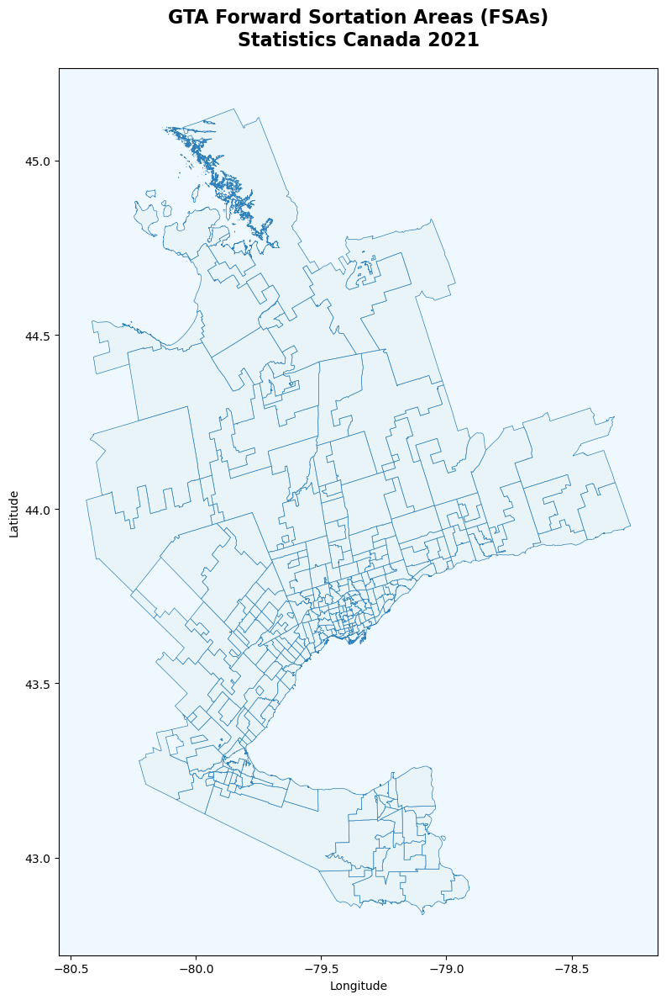

✅ Base map saved → reports/gta_fsa_base_map.png


In [4]:
fig, ax = plt.subplots(1, 1, figsize=(14, 12))

gdf_gta.plot(
    ax=ax,
    color='#e8f4f8',
    edgecolor='#2c7fb8',
    linewidth=0.5
)

ax.set_title('GTA Forward Sortation Areas (FSAs)\nStatistics Canada 2021',
             fontsize=16, fontweight='bold', pad=20)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
ax.set_facecolor('#f0f8ff')
fig.patch.set_facecolor('white')

os.makedirs('../reports', exist_ok=True)
plt.tight_layout()
plt.savefig('../reports/gta_fsa_base_map.png', dpi=150, bbox_inches='tight')
plt.show()
print('✅ Base map saved → reports/gta_fsa_base_map.png')

## 4️⃣ Load GTA Hospital Locations

In [5]:
hospitals = pd.DataFrame({
    'name': [
        'Sunnybrook Health Sciences Centre',
        'Toronto General Hospital (UHN)',
        'Toronto Western Hospital (UHN)',
        'Princess Margaret Cancer Centre (UHN)',
        "St. Michael's Hospital (Unity Health)",
        "St. Joseph's Health Centre (Unity Health)",
        'The Hospital for Sick Children (SickKids)',
        'Mount Sinai Hospital',
        'North York General Hospital',
        'Humber River Health',
        'Scarborough Health Network - General',
        'Scarborough Health Network - Centenary',
        'Michael Garron Hospital',
        'Trillium Health Partners - Mississauga',
        'Mackenzie Health - Richmond Hill',
        'Lakeridge Health - Oshawa',
        'William Osler - Brampton Civic'
    ],
    'lat': [
        43.7234, 43.6591, 43.6532, 43.6570,
        43.6532, 43.6384, 43.6566, 43.6574,
        43.7615, 43.7350, 43.7730, 43.7827,
        43.6929, 43.5890, 43.8722, 43.8975,
        43.6855
    ],
    'lon': [
        -79.3777, -79.3893, -79.4170, -79.3910,
        -79.3791, -79.4278, -79.3955, -79.3884,
        -79.4100, -79.5380, -79.2317, -79.2240,
        -79.3358, -79.6444, -79.4317, -78.8619,
        -79.7624
    ],
    'type': [
        'Academic', 'Academic', 'Academic', 'Academic',
        'Academic', 'Community', 'Pediatric', 'Academic',
        'Community', 'Community', 'Community', 'Community',
        'Community', 'Community', 'Community', 'Community',
        'Community'
    ]
})

print(f'✅ {len(hospitals)} GTA hospitals loaded')
hospitals

✅ 17 GTA hospitals loaded


,name,lat,lon,type
0,Sunnybrook Health Sciences Centre,43.7234,-79.3777,Academic
1,Toronto General Hospital (UHN),43.6591,-79.3893,Academic
2,Toronto Western Hospital (UHN),43.6532,-79.4170,Academic
3,Princess Margaret Cancer Centre (UHN),43.6570,-79.3910,Academic
4,St. Michael's Hospital (Unity Health),43.6532,-79.3791,Academic
5,St. Joseph's Health Centre (Unity Health),43.6384,-79.4278,Community
6,The Hospital for Sick Children (SickKids),43.6566,-79.3955,Pediatric
7,Mount Sinai Hospital,43.6574,-79.3884,Academic
8,North York General Hospital,43.7615,-79.4100,Community
9,Humber River Health,43.7350,-79.5380,Community


## 5️⃣ Generate Synthetic ED Wait Time & Equity Data
> ⚠️ Synthetic data — will be replaced with real NACRS data in Module 1

In [6]:
np.random.seed(42)
n = len(gdf_gta)

gdf_gta['avg_wait_hrs'] = np.where(
    gdf_gta['CFSAUID'].str.startswith('M'),
    np.random.normal(4.2, 1.1, n).clip(1.5, 9.0),
    np.random.normal(3.5, 0.9, n).clip(1.0, 7.5)
)

gdf_gta['equity_score'] = np.random.uniform(30, 95, n).round(1)

scarborough = gdf_gta['CFSAUID'].str.startswith('M1')
gdf_gta.loc[scarborough, 'avg_wait_hrs'] += np.random.uniform(0.8, 2.2, scarborough.sum())
gdf_gta.loc[scarborough, 'equity_score'] -= np.random.uniform(10, 25, scarborough.sum())
gdf_gta['equity_score'] = gdf_gta['equity_score'].clip(0, 100)

print('✅ Synthetic ED metrics generated')
print(f'   Avg wait — Toronto    : {gdf_gta[gdf_gta["CFSAUID"].str.startswith("M")]["avg_wait_hrs"].mean():.2f} hrs')
print(f'   Avg wait — Outer GTA  : {gdf_gta[~gdf_gta["CFSAUID"].str.startswith("M")]["avg_wait_hrs"].mean():.2f} hrs')
print(f'   Avg wait — Scarborough: {gdf_gta[scarborough]["avg_wait_hrs"].mean():.2f} hrs')
gdf_gta[['CFSAUID', 'avg_wait_hrs', 'equity_score']].head(10)

✅ Synthetic ED metrics generated
   Avg wait — Toronto    : 4.60 hrs
   Avg wait — Outer GTA  : 3.56 hrs
   Avg wait — Scarborough: 6.14 hrs


,CFSAUID,avg_wait_hrs,equity_score
727,L0A,2.665763,67.2
728,L0B,3.446427,48.2
729,L0C,1.000000,80.0
730,L0E,2.578051,42.2
731,L0G,3.272689,51.0
732,L0H,2.376995,57.7
733,L0J,4.969170,63.0
734,L0K,2.212873,45.8
735,L0L,3.103960,37.5
736,L0M,3.617667,69.7


## 6️⃣ Side-by-Side Choropleth Maps

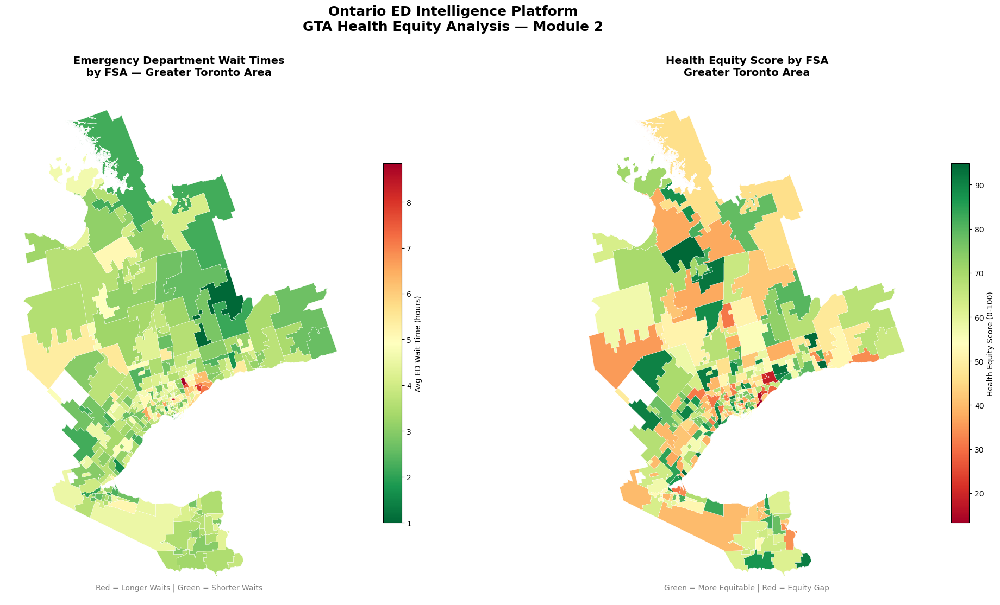

✅ Heatmap saved → reports/gta_equity_heatmap.png


In [7]:
fig, axes = plt.subplots(1, 2, figsize=(22, 11))

gdf_gta.plot(
    column='avg_wait_hrs', ax=axes[0], cmap='RdYlGn_r', legend=True,
    legend_kwds={'label': 'Avg ED Wait Time (hours)', 'shrink': 0.7},
    edgecolor='white', linewidth=0.3, missing_kwds={'color': 'lightgrey'}
)
axes[0].set_title('Emergency Department Wait Times\nby FSA — Greater Toronto Area',
                   fontsize=14, fontweight='bold', pad=15)
axes[0].set_axis_off()
axes[0].annotate('Red = Longer Waits | Green = Shorter Waits',
                  xy=(0.5, 0.02), xycoords='axes fraction',
                  ha='center', fontsize=10, color='grey')

gdf_gta.plot(
    column='equity_score', ax=axes[1], cmap='RdYlGn', legend=True,
    legend_kwds={'label': 'Health Equity Score (0-100)', 'shrink': 0.7},
    edgecolor='white', linewidth=0.3, missing_kwds={'color': 'lightgrey'}
)
axes[1].set_title('Health Equity Score by FSA\nGreater Toronto Area',
                   fontsize=14, fontweight='bold', pad=15)
axes[1].set_axis_off()
axes[1].annotate('Green = More Equitable | Red = Equity Gap',
                  xy=(0.5, 0.02), xycoords='axes fraction',
                  ha='center', fontsize=10, color='grey')

fig.suptitle('Ontario ED Intelligence Platform\nGTA Health Equity Analysis — Module 2',
             fontsize=18, fontweight='bold', y=1.01)

plt.tight_layout()
plt.savefig('../reports/gta_equity_heatmap.png', dpi=150, bbox_inches='tight')
plt.show()
print('✅ Heatmap saved → reports/gta_equity_heatmap.png')

## 7️⃣ Interactive Folium Map with All GTA Hospitals

In [8]:
m = folium.Map(
    location=[43.7200, -79.3800],
    zoom_start=10,
    tiles='CartoDB positron'
)

folium.Choropleth(
    geo_data=gdf_gta.__geo_interface__,
    data=gdf_gta,
    columns=['CFSAUID', 'avg_wait_hrs'],
    key_on='feature.properties.CFSAUID',
    fill_color='RdYlGn_r',
    fill_opacity=0.65,
    line_opacity=0.2,
    legend_name='Average ED Wait Time (hours)',
    name='ED Wait Times by FSA'
).add_to(m)

colour_map = {'Academic': 'red', 'Community': 'blue', 'Pediatric': 'purple'}
icon_map   = {'Academic': 'plus', 'Community': 'info-sign', 'Pediatric': 'star'}

for _, row in hospitals.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=folium.Popup(f"<b>{row['name']}</b><br>Type: {row['type']}", max_width=280),
        tooltip=row['name'],
        icon=folium.Icon(color=colour_map[row['type']], icon=icon_map[row['type']], prefix='glyphicon')
    ).add_to(m)

legend_html = '''
<div style="position:fixed;bottom:40px;left:40px;z-index:9999;
     background:white;padding:12px 16px;border-radius:8px;
     border:2px solid #ccc;font-size:13px;box-shadow:2px 2px 6px rgba(0,0,0,0.3);">
  <b>🏥 Hospital Type</b><br><br>
  <span style="color:red;">📍</span>&nbsp;Academic Health Science Centre<br>
  <span style="color:blue;">📍</span>&nbsp;Community Hospital<br>
  <span style="color:purple;">📍</span>&nbsp;Pediatric Hospital<br><br>
  <small style="color:grey;">Ontario ED Intelligence Platform</small>
</div>
'''
m.get_root().html.add_child(folium.Element(legend_html))
folium.LayerControl().add_to(m)

m.save('../reports/gta_interactive_map.html')
print('✅ Interactive map saved → reports/gta_interactive_map.html')
print('   Open in your browser to explore!')
m

✅ Interactive map saved → reports/gta_interactive_map.html
   Open in your browser to explore!


## 8️⃣ Summary Statistics

In [9]:
worst_fsa = gdf_gta.loc[gdf_gta['avg_wait_hrs'].idxmax()]
best_fsa  = gdf_gta.loc[gdf_gta['avg_wait_hrs'].idxmin()]
low_eq    = gdf_gta.loc[gdf_gta['equity_score'].idxmin()]

print('=' * 55)
print('  GTA ED INTELLIGENCE — EDA SUMMARY')
print('=' * 55)
print(f'  Total GTA FSAs analysed   : {len(gdf_gta)}')
print(f'  Hospitals mapped          : {len(hospitals)}')
print(f'  Avg ED wait (all GTA)     : {gdf_gta["avg_wait_hrs"].mean():.2f} hrs')
print(f'  Worst FSA                 : {worst_fsa["CFSAUID"]} — {worst_fsa["avg_wait_hrs"]:.2f} hrs')
print(f'  Best FSA                  : {best_fsa["CFSAUID"]}  — {best_fsa["avg_wait_hrs"]:.2f} hrs')
print(f'  Lowest equity FSA         : {low_eq["CFSAUID"]} — score {low_eq["equity_score"]:.1f}/100')
print('=' * 55)
print()
print('📁 Outputs:')
print('   reports/gta_fsa_base_map.png')
print('   reports/gta_equity_heatmap.png')
print('   reports/gta_interactive_map.html')
print()
print('🚀 Next → Module 1: ED Surge Forecasting')

  GTA ED INTELLIGENCE — EDA SUMMARY
  Total GTA FSAs analysed   : 260
  Hospitals mapped          : 17
  Avg ED wait (all GTA)     : 3.95 hrs
  Worst FSA                 : M1W — 8.84 hrs
  Best FSA                  : L0C  — 1.00 hrs
  Lowest equity FSA         : M1N — score 13.3/100

📁 Outputs:
   reports/gta_fsa_base_map.png
   reports/gta_equity_heatmap.png
   reports/gta_interactive_map.html

🚀 Next → Module 1: ED Surge Forecasting
